두개골 제거 전처리까지 추가한 버전

# Library install

In [43]:
pip install nibabel pandas numpy scipy openpyxl imageio

Defaulting to user installation because normal site-packages is not writeable

[notice] A new release of pip is available: 23.2.1 -> 24.2
[notice] To update, run: /Library/Developer/CommandLineTools/usr/bin/python3 -m pip install --upgrade pip
Note: you may need to restart the kernel to use updated packages.


# Preprocessing

# 0. Import Library

In [44]:
import os
import imageio
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import nibabel as nib
import cv2
from scipy.ndimage import zoom
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder

## 1. Load Data

In [45]:
# 경로 설정
data_dir = "./data/"
save_dir = "./dataset/"
excel_file_path = data_dir+"oasis_cross-sectional-excel.xlsx"

# 변환된 파일을 저장하는 디렉토리 설정
output_directory_gif = save_dir+"output_gif"
output_directory_nifti = save_dir+"output_nifti"

In [46]:
# 엑셀 파일에서 인구통계학적 정보를 데이터프레임으로 로드 - 모든 정보를 가져옴
df = pd.read_excel(excel_file_path)
df = df[['ID', 'M/F', 'Hand', 'Age', 'Educ', 'SES', 'MMSE', 'CDR', 'eTIV', 'nWBV', 'ASF', 'Delay']]

# CDR 값이 없는 경우, 결측값으로 간주하고 제거
df = df.dropna(subset=['CDR'])

In [47]:
# MRI, label, 인구통계 정보를 위한 리스트와 딕셔너리 생성
coronal_images = {}
sagittal_images = {}
transverse_images = {}
transverse_images_stripped = {}
transverse_images_masked = {}

labels = []
demographics = {}

In [48]:
# git에서 nifti로 변환하는 함수 
def convert_gif_to_nifti(gif_file):
    # GIF 파일을 읽고 모든 프레임을 이미지 배열로 변환
    gif_images = imageio.mimread(gif_file)  # 모든 프레임 읽기
    gif_array = np.array([np.array(img) for img in gif_images])  # 각 프레임을 numpy 배열로 변환

    # NIfTI 이미지 생성
    # GIF 배열의 차원 변경 (height, width, slices)
    gif_array = np.transpose(gif_array, (1, 2, 0))  # (slices, height, width)에서 (height, width, slices)로 변경

    nifti_img = nib.Nifti1Image(gif_array, affine=np.eye(4))  # 단위 행렬을 사용하여 affine 설정
    nifti_file = gif_file.replace('.gif', '.nii.gz')  # NIfTI 파일 이름 생성
    nib.save(nifti_img, nifti_file)  # NIfTI 파일로 저장
    return nifti_file

In [49]:
# nifti에서 gif로 변환하는 함수
def convert_nifti_to_gif(stripped_nifti_path, output_directory):
    # NIfTI 파일 읽기
    nifti_img = nib.load(stripped_nifti_path)
    data = nifti_img.get_fdata()  # NIfTI 이미지에서 데이터 추출

    # 출력 디렉토리 생성 (없으면)
    if not os.path.exists(output_directory):
        os.makedirs(output_directory)

    gif_filenames = []  # 저장된 GIF 파일 이름 리스트

    # 각 슬라이스를 GIF로 저장
    for i in range(data.shape[2]):  # z축 방향으로 슬라이스 반복
        slice_data = data[:, :, i]  # i번째 슬라이스 추출
        slice_image = (slice_data * 255).astype(np.uint8)  # 픽셀 값을 0-255로 변환
        
        # GIF 파일 이름 생성
        gif_file = os.path.join(output_directory, f"slice_{i}.gif")
        
        # 슬라이스 이미지를 GIF로 저장
        imageio.imwrite(gif_file, slice_image)

        gif_filenames.append(gif_file)  # 저장된 GIF 파일 이름 추가
    
    # 첫 번째 슬라이스의 GIF 파일 경로 반환 (원하는 경우 다른 슬라이스로 변경 가능)
    return gif_filenames[0] if gif_filenames else None

In [50]:
# 이미지 크기 조정 함수 정의 (이미지를 224x224로 변환)
def resize_image(image, new_shape=(224, 224)):
    current_shape = image.shape[:2]  # 2D 이미지이므로 앞의 두 차원만 사용
    zoom_factors = [n / c for n, c in zip(new_shape, current_shape)]
    return zoom(image, zoom_factors)

In [51]:
# 두개골 제거 함수 
def apply_skull_stripping(nifti_file):
    # NIfTI 파일 읽기
    nifti_img = nib.load(nifti_file)
    data = nifti_img.get_fdata()  # 데이터 추출

    # 데이터에 대해 스컬 스트리핑을 수행
    stripped_data = np.zeros_like(data)
    
    for i in range(data.shape[2]):  # 각 슬라이스에 대해
        slice_data = data[:, :, i]  # 슬라이스 추출
        slice_data = (slice_data - np.min(slice_data)) / (np.max(slice_data) - np.min(slice_data)) * 255
        slice_data = slice_data.astype(np.uint8)

        # 이미지 이진화
        _, binary_slice = cv2.threshold(slice_data, 50, 255, cv2.THRESH_BINARY)

        # 윤곽선 찾기
        contours, _ = cv2.findContours(binary_slice, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
        
        if contours:
            # 가장 큰 윤곽선 선택
            largest_contour = max(contours, key=cv2.contourArea)

            # 마스크 생성
            mask = np.zeros_like(binary_slice)
            cv2.drawContours(mask, [largest_contour], -1, 1, thickness=cv2.FILLED)

            # 슬라이스에 마스크 적용
            stripped_data[:, :, i] = slice_data * mask

    # NIfTI 이미지 생성
    stripped_nifti_img = nib.Nifti1Image(stripped_data, affine=nifti_img.affine)

    return stripped_nifti_img

In [52]:
# 사이즈, 형 변환 후 두개골 제거된 데이터를 저장하는 함수 
def preprocess(file_path, subject_dir, type, type_images):
    # GIF 파일을 NIfTI 형식으로 변환
    nifti_file = convert_gif_to_nifti(file_path)
    print("nifti transform done")

    # Skull stripping 적용 (두개골 제거)
    stripped_img = apply_skull_stripping(nifti_file)
    print("skull stripping done")
    
    # 피험자별 폴더 경로 설정
    subject_output_dir = os.path.join(output_directory_nifti, subject_dir)

    # 피험자 별 폴더 생성
    subject_output_dir = os.path.join(output_directory_nifti, subject_dir)
    if not os.path.exists(subject_output_dir):
        os.makedirs(subject_output_dir)

    # 두개골 제거 후 결과를 NIfTI 파일로 저장
    stripped_nifti_path = os.path.join(subject_output_dir, f"{subject_dir}_stripped_{type}.nii.gz")
    nib.save(stripped_img, stripped_nifti_path)

    # NIfTI 파일을 GIF로 변환
    gif_file = convert_nifti_to_gif(stripped_nifti_path, output_directory_gif)

    # 변환된 GIF 이미지를 다시 로드
    transformed_image = imageio.v2.imread(gif_file, mode='L')
    resized_image = resize_image(transformed_image)
    
    type_images[subject_dir] = resized_image

In [53]:
# 피험자 ID와 df 값을 매칭하여 딕셔너리에 저장하는 함수
def save_dictionary(subject_id):
    # 엑셀에서 해당 ID를 매칭하고 정보를 찾기
    subject_info = df[df['ID'] == subject_id]

    if not subject_info.empty:
        # CDR 값을 label로 사용
        cdr_value = subject_info['CDR'].values[0]
        labels.append(cdr_value)

        # 인구통계학적 정보 딕셔너리에 저장
        demographics[subject_id] = {
            'M/F': subject_info['M/F'].values[0],
            'Hand': subject_info['Hand'].values[0],
            'Age': subject_info['Age'].values[0],
            'Educ': subject_info['Educ'].values[0],
            'SES': subject_info['SES'].values[0],
            'MMSE': subject_info['MMSE'].values[0],
            'eTIV': subject_info['eTIV'].values[0],
            'nWBV': subject_info['nWBV'].values[0],
            'ASF': subject_info['ASF'].values[0],
            'Delay': subject_info['Delay'].values[0]
        }
    else:
        print(f"Label not found for subject: {subject_id}")  # label이 없는 피험자 출력

In [54]:
# 피험자 데이터 로드 및 저장
for disc_num in range(1, 13):  # 1~12 디스크 (OASIS 디스크 12개)
    disc_path = os.path.join(data_dir, f"oasis_cross-sectional_disc{disc_num}")

    # [디버깅] 디스크 경로가 존재하는지 확인
    if not os.path.exists(disc_path):
        print(f"Disc path does not exist: {disc_path}")
        continue

    for sub_folder in os.listdir(disc_path):  # disc 안의 폴더 탐색
        sub_folder_path = os.path.join(disc_path, sub_folder)

        if not os.path.isdir(sub_folder_path):  # [디버깅] 폴더가 아닌 경우 무시
            print(f"Skipping non-directory: {sub_folder_path}")
            continue

        for subject_dir in os.listdir(sub_folder_path):  # 피험자 폴더 탐색
            subject_path = os.path.join(sub_folder_path, subject_dir)

            if not os.path.isdir(subject_path): # [디버깅] 폴더가 아닌 경우 무시
                print(f"Skipping non-directory: {subject_path}")
                continue

            # MR1 경로 설정
            session_path = subject_path
            print(f"Processing session: {session_path}")

            if not os.path.exists(session_path): # [디버깅]
                print(f"Session path does not exist: {session_path}")
                continue

            # preprocessed 데이터 경로 (T88_111 폴더)
            t88_111_path = os.path.join(session_path, "PROCESSED", "MPRAGE", "T88_111")
            print(f"Checking T88_111 path: {t88_111_path}")

            if os.path.exists(t88_111_path):
                for file in os.listdir(t88_111_path):
                    file_path = os.path.join(t88_111_path, file)

                    # coronal 이미지 처리
                    if file.endswith("_cor_110.gif"):
                        print(f"Loading coronal .gif file: {file_path}")
                        try:
                            preprocess(file_path, subject_dir, "cor", coronal_images)
                        except Exception as e: # [디버깅]
                            print(f"Error loading coronal image: {e}")

                    # sagittal 이미지 처리
                    elif file.endswith("_sag_95.gif"):
                        print(f"Loading sagittal .gif file: {file_path}")
                        try:
                            preprocess(file_path, subject_dir, "sag", sagittal_images)
                        except Exception as e: # [디버깅]
                            print(f"Error loading sagittal image: {e}")

                    # transverse 이미지 처리
                    elif file.endswith("_tra_90.gif"):
                        # masked 데이터 불러오기
                        if "masked_gfc" in file:
                            print(f"Loading masked transverse .gif file: {file_path}", transverse_images_masked)
                            try:
                                img = imageio.v2.imread(file_path)
                                img_resized = resize_image(img)
                                transverse_images_masked[subject_dir] = img_resized
                            except Exception as e: # [디버깅]
                                print(f"Error loading masked transverse image: {e}")

                        # raw 데이터 불러오기
                        print(f"Loading regular transverse .gif file: {file_path}")
                        try:
                            img = imageio.v2.imread(file_path)
                            img_resized = resize_image(img)
                            transverse_images[subject_dir] = img_resized
                        except Exception as e: # [디버깅]
                            print(f"Error loading regular transverse image: {e}")

                        # 두개골 제거 데이터 
                        print(f"Loading regular transverse .gif file: {file_path}")
                        try:
                            preprocess(file_path, subject_dir, "tra", transverse_images_stripped)
                        except Exception as e: #[디버깅]
                            print(f"Error loading regular transverse image: {e}")
                        
    
                    # 피험자 ID 그대로 추출
                    subject_id = subject_dir

                    # 피험자 ID와 엑셀 파일상 데이터 매칭하여 딕셔너리에 저장
                    save_dictionary(subject_id)
            else:
                print(f"T88_111 path does not exist: {t88_111_path}")

Skipping non-directory: ./data/oasis_cross-sectional_disc1/.DS_Store
Skipping non-directory: ./data/oasis_cross-sectional_disc1/disc1/.DS_Store
Processing session: ./data/oasis_cross-sectional_disc1/disc1/OAS1_0016_MR1
Checking T88_111 path: ./data/oasis_cross-sectional_disc1/disc1/OAS1_0016_MR1/PROCESSED/MPRAGE/T88_111
Loading masked transverse .gif file: ./data/oasis_cross-sectional_disc1/disc1/OAS1_0016_MR1/PROCESSED/MPRAGE/T88_111/OAS1_0016_MR1_mpr_n3_anon_111_t88_masked_gfc_tra_90.gif {}
Loading regular transverse .gif file: ./data/oasis_cross-sectional_disc1/disc1/OAS1_0016_MR1/PROCESSED/MPRAGE/T88_111/OAS1_0016_MR1_mpr_n3_anon_111_t88_masked_gfc_tra_90.gif
Loading regular transverse .gif file: ./data/oasis_cross-sectional_disc1/disc1/OAS1_0016_MR1/PROCESSED/MPRAGE/T88_111/OAS1_0016_MR1_mpr_n3_anon_111_t88_masked_gfc_tra_90.gif
nifti transform done
skull stripping done
Loading coronal .gif file: ./data/oasis_cross-sectional_disc1/disc1/OAS1_0016_MR1/PROCESSED/MPRAGE/T88_111/OAS1_

## 2. Preprocessing

### 1) 결측치 처리

label와 mri가 동시에 존재하는 피실험자만 데이터셋으로 사용하기

In [56]:
valid_subjects = [subject for subject in demographics if subject in df['ID'].values]
coronal_images = {subject: coronal_images[subject] for subject in valid_subjects if subject in coronal_images}
sagittal_images = {subject: sagittal_images[subject] for subject in valid_subjects if subject in sagittal_images}
transverse_images = {subject: transverse_images[subject] for subject in valid_subjects if subject in transverse_images}
transverse_images_stripped = {subject: transverse_images_stripped[subject] for subject in valid_subjects if subject in transverse_images_stripped}
transverse_images_masked = {subject: transverse_images_masked[subject] for subject in valid_subjects if subject in transverse_images_masked}

# 라벨
labels = [df[df['ID'] == subject]['CDR'].values[0] for subject in valid_subjects]
coronal_labels = [df[df['ID'] == subject]['CDR'].values[0] for subject in valid_subjects if subject in coronal_images]
sagittal_labels = [df[df['ID'] == subject]['CDR'].values[0] for subject in valid_subjects if subject in sagittal_images]
transverse_labels = [df[df['ID'] == subject]['CDR'].values[0] for subject in valid_subjects if subject in transverse_images]
transverse_stripped_labels = [df[df['ID'] == subject]['CDR'].values[0] for subject in valid_subjects if subject in transverse_images_stripped]
transverse_masked_labels = [df[df['ID'] == subject]['CDR'].values[0] for subject in valid_subjects if subject in transverse_images_masked]

In [62]:
# 최종 저장된 정보 출력
print(f"Coronal images: {len(coronal_images)}")
print(f"Sagittal images: {len(sagittal_images)}")
print(f"Regular transverse images: {len(transverse_images)}")
print(f"Stripped transverse images: {len(transverse_images_stripped)}")
print(f"Masked transverse images: {len(transverse_images_masked)}\n")

# 각 부위별 라벨 내용 출력
print(f"Total labels: {len(labels)}")
print(f"Coronal labels: {len(coronal_labels)}")
print(f"Sagittal labels: {len(sagittal_labels)}")
print(f"Regular transverse images: {len(transverse_labels)}")
print(f"Stripped transverse labels: {len(transverse_stripped_labels)}")
print(f"Masked transverse labels: {len(transverse_masked_labels)}\n")

print(f"저장된 피험자 수: {len(demographics)}")

Coronal images: 212
Sagittal images: 212
Regular transverse images: 213
Stripped transverse images: 213
Masked transverse images: 213

Total labels: 223
Coronal labels: 212
Sagittal labels: 212
Regular transverse images: 213
Stripped transverse labels: 213
Masked transverse labels: 213

저장된 피험자 수: 223


### 2) Label encoding

In [63]:
def convert_images_to_array(image_dict):
    image_array = []
    for img in image_dict.values():
        # if 이미지가 흑백인 경우 : 채널을 추가하는 코드 - 모델에 입력 가능한 형태인 (height, width, 1)로 맞춤
        if len(img.shape) == 2:
            img = np.expand_dims(img, axis=-1)
        image_array.append(img)
    return np.array(image_array)

In [64]:
# 정규화 함수 (이미지의 픽셀 값을 0에서 1 사이로 정규화)
def normalize_image(image):
    # 이미지가 비어 있지 않은지 확인
    if image.size > 0:
        # 이미지의 최대값이 0이 아니어야 정규화를 진행
        if image.max() > 0:
            return image / 255.0
    return image

In [65]:
# 파트별로 나누고 정규화하여 array 저장
for part in ['coronal', 'sagittal', 'transverse', 'transverse_stripped', 'transverse_masked']:
    if part == 'coronal':
        coronal_array = convert_images_to_array({subject: coronal_images[subject] for subject in valid_subjects if subject in coronal_images})
        coronal_array = normalize_image(coronal_array)
    elif part == 'sagittal':
        sagittal_array = convert_images_to_array({subject: sagittal_images[subject] for subject in valid_subjects if subject in sagittal_images})
        sagittal_array = normalize_image(sagittal_array)
    elif part == 'transverse':
        transverse_array = convert_images_to_array({subject: transverse_images[subject] for subject in valid_subjects if subject in transverse_images})
        transverse_array = normalize_image(transverse_array)
    elif part == 'transverse_stripped':
        transverse_stripped_array = convert_images_to_array({subject: transverse_images_stripped[subject] for subject in valid_subjects if subject in transverse_images_stripped})
        transverse_stripped_array = normalize_image(transverse_stripped_array)
    elif part == 'transverse_masked':
        transverse_masked_array = convert_images_to_array({subject: transverse_images_masked[subject] for subject in valid_subjects if subject in transverse_images_masked})
        transverse_masked_array = normalize_image(transverse_masked_array)

In [67]:
# 이미지 배열 저장
image_types = ['coronal', 'sagittal', 'transverse', 'transverse_stripped', 'transverse_masked']
for image_type in image_types:
    np.save(save_dir + f"data_{image_type}.npy", eval(f"{image_type}_array"))

# 각 부위별 label 저장
for image_type in image_types:
    np.save(save_dir + f"labels_{image_type}.npy", np.array(eval(f"{image_type}_labels")))

# Visualising

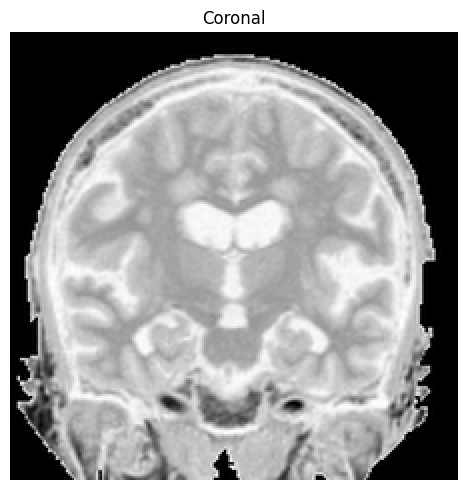

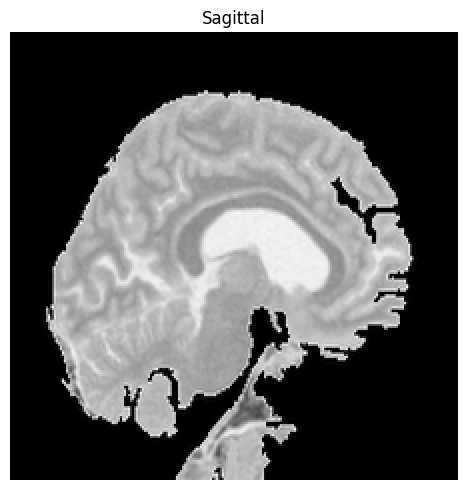

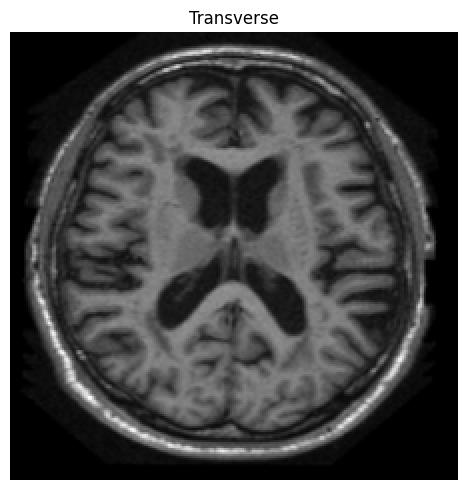

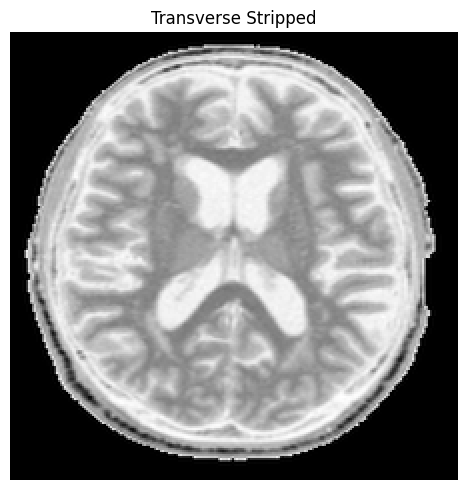

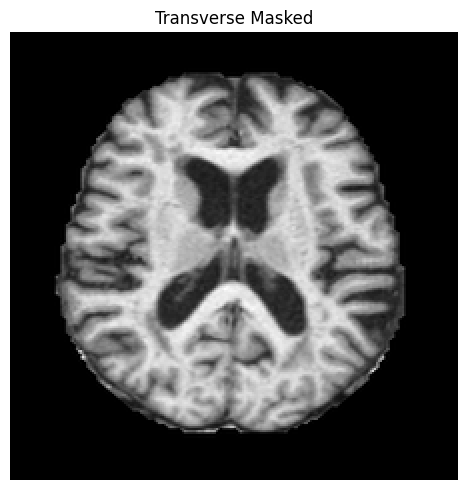

In [74]:
# 이미지 시각화 함수 정의
def display_sample_images(image_arrays, titles, cmap='gray'):
    # 이미지 배열과 제목 리스트의 길이가 같아야 함
    assert len(image_arrays) == len(titles)

    plt.figure(figsize=(10, 5))
    for i, (image, title) in enumerate(zip(image_arrays, titles)):
        plt.subplot(1, len(image_arrays), i+1)
        plt.imshow(image.squeeze(), cmap=cmap)
        plt.title(title)
        plt.axis('off')
    plt.tight_layout()
    plt.show()

# 샘플 이미지를 시각화 (정규화된 이미지 확인)
def visualize_samples():
    # Coronal, Sagittal, Transverse 3종 각각 첫 번째 샘플 이미지 시각화
    sample_coronal = [coronal_array[0]]
    sample_sagittal = [sagittal_array[0]]
    sample_transverse = [transverse_array[0]]
    sample_transverse_stripped = [transverse_stripped_array[0]]
    sample_transverse_masked = [transverse_masked_array[0]]

    # Coronal 이미지 시각화
    display_sample_images(sample_coronal, ["Coronal"])

    # Sagittal 이미지 시각화
    display_sample_images(sample_sagittal, ["Sagittal"])

    # Transverse  이미지 시각화
    display_sample_images(sample_transverse, ["Transverse"])

    # Transverse Stripped 이미지 시각화
    display_sample_images(sample_transverse_stripped, ["Transverse Stripped"])

    # Transverse Masked 이미지 시각화
    display_sample_images(sample_transverse_masked, ["Transverse Masked"])

# 샘플 이미지 시각화 실행
visualize_samples()
